In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
pip install geopandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.0 MB 4.6 MB/s 
     |████████████████████████████████| 6.3 MB 26.1 MB/s 
     |████████████████████████████████| 16.7 MB 278 kB/s 


In [ ]:
pip install folium

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import geopandas as gpd
import folium

In [ ]:
df = gpd.read_file('/content/drive/MyDrive/Project/빅콘테스트/dataset/data_merge_ing3.geojson')
df.columns

Index(['id', '시군구', '읍면동', 'charger_slow_num', 'charger_slow_amount',
       'charger_fast_num', 'charger_fast_amount', 'new_apart_num',
       'new_apart_live', 'old_apart_num', 'old_apart_live', 'small_apart_num',
       'small_apart_live', 'population_live', 'traffic_num', 'total_car',
       'total_elect_car', 'height', 'river_count', 'parking_lot', '주거',
       'neighborhood', '문화집회', '종교', '판매', '의료', '교육연구', '운동', '업무', '숙박',
       '위락', '주유소', '자동차', '관광휴게', '공업', 'resident_app_use_count',
       'activity_resident_app_use_count', 'activity_app_use_count',
       'activity_resident_commute_app_use_count',
       'activity_commute_app_use_count', 'apart_num', 'apart_live',
       'total_charger_num', 'total_charger_amount', 'No', 'gas', 'Nox',
       'ozone', 'dust', 'geometry'],
      dtype='object')

In [ ]:
grade = gpd.read_file('/content/drive/MyDrive/Project/빅콘테스트/dataset/final_total_wheather.geojson')
grade.columns

Index(['id', '시군구', '읍면동', 'population_live', 'traffic_num', 'total_car',
       'total_elect_car', 'parking_lot', '주거', 'neighborhood', '문화집회', '종교',
       '판매', '의료', '교육연구', '운동', '업무', '숙박', '위락', '주유소', '자동차', '관광휴게', '공업',
       'resident_app_use_count', 'activity_resident_app_use_count',
       'activity_app_use_count', 'apart_num', 'No', 'gas', 'Nox', 'ozone',
       'dust', 'slow_charger', 'grade', 'geometry'],
      dtype='object')

In [ ]:
# 지도시각화
def sigungu0(M):
    loc='/content/drive/MyDrive/Project/빅콘테스트/dataset/Extra/★13.용인시_행정경계(읍면동).geojson'
    style = {'color': 'Gray','fillOpacity':0.2 }
    folium.GeoJson(    
        loc,
        name='13.용인시_행정경계(읍면동).geojson',
        style_function=lambda x:style    
    ).add_to(M) 
    return M

In [ ]:
# 아파트 분포 

colname = '아파트분포'
data1 = df[df['new_apart_num'] != 0]
data2 = df[df['old_apart_num'] != 0]
data3 = df[df['small_apart_num'] != 0]


m = folium.Map(location=(37.1778, 127.178), zoom_start=11, tiles='cartodbpositron')
folium.GeoJson(data1['geometry'], style_function = lambda feature: {
    'fillColor' : 'red',
    'color':'red',
    'fill' : True,
    'legend_name' : 'new_apart_num'
}).add_to(m)
folium.GeoJson(data2['geometry'], style_function = lambda feature: {
    'fillColor' : 'blue',
    'color':'blue',
    'fill' : True,
    'legend_name' : 'old_apart_num'
}).add_to(m)
folium.GeoJson(data3['geometry'], style_function = lambda feature: {
    'fillColor' : 'green',
    'color':'green',
    'fill' : True,
    'legend_name' : 'small_apart_num'
}).add_to(m)
sigungu0(m)
m.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
m

In [ ]:
colname = '세대수'
data = df[['읍면동', 'old_apart_live', 'new_apart_live', 'small_apart_live']]
data['total_live'] = df['old_apart_live'] + df['new_apart_live'] + df['small_apart_live']
data = data.groupby('읍면동').sum()[['total_live']]
data = data.reset_index()
data.columns = ['name','values']

mymap = folium.Map(location=[37.1778, 127.178], zoom_start=11, tiles = 'cartodbpositron')
mymap.choropleth(
    geo_data='/content/drive/MyDrive/Project/빅콘테스트/dataset/Extra/★13.용인시_행정경계(읍면동).geojson',
    data= data,
    columns = ['name', 'values'],
    key_on='properties.ADM_DR_NM',
    fill_color="YlGn")
mymap.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
mymap

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  del sys.path[0]
/usr/local/lib/python3.7/dist-packages/folium/folium.py:413: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


In [ ]:
colname = '충전소'
data1 = df[df['charger_slow_num'] != 0]
data2 = df[df['charger_fast_num'] != 0]

m = folium.Map(location=(37.1778, 127.178), zoom_start=11, tiles='cartodbpositron')
folium.GeoJson(data1['geometry'], style_function = lambda feature: {
    'fillColor' : 'red',
    'color':'red',
    'fill' : True,
    'legend_name' : 'charger_slow_num'
}).add_to(m)
folium.GeoJson(data2['geometry'], style_function = lambda feature: {
    'fillColor' : 'green',
    'color':'green',
    'fill' : True,
    'legend_name' : 'charger_fast_num'
}).add_to(m)
sigungu0(m)
m.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
m

In [ ]:
df.columns

Index(['id', '시군구', '읍면동', 'charger_slow_num', 'charger_slow_amount',
       'charger_fast_num', 'charger_fast_amount', 'new_apart_num',
       'new_apart_live', 'old_apart_num', 'old_apart_live', 'small_apart_num',
       'small_apart_live', 'population_live', 'traffic_num', 'total_car',
       'total_elect_car', 'height', 'river_count', 'parking_lot', '주거',
       'neighborhood', '문화집회', '종교', '판매', '의료', '교육연구', '운동', '업무', '숙박',
       '위락', '주유소', '자동차', '관광휴게', '공업', 'resident_app_use_count',
       'activity_resident_app_use_count', 'activity_app_use_count',
       'activity_resident_commute_app_use_count',
       'activity_commute_app_use_count', 'apart_num', 'apart_live',
       'total_charger_num', 'total_charger_amount', 'No', 'gas', 'Nox',
       'ozone', 'dust', 'geometry'],
      dtype='object')

In [ ]:
colname = '도로'

data1 = df[df['traffic_num'] != 0]
m = folium.Map(location=(37.1778, 127.178), zoom_start=11, tiles='cartodbpositron')
folium.GeoJson(data1['geometry'], style_function = lambda feature: {
    'fillColor' : 'orange',
    'color':'orange',
    'fill' : True,
    'legend_name' : 'charger_slow_num'
}).add_to(m)
sigungu0(m)
m.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
m

In [ ]:
colname = 'live_area'
data = df[['읍면동', 'live_area_count']]
data = data.groupby('읍면동').sum()
data = data.reset_index()
data.columns = ['name','values']

mymap = folium.Map(location=[37.1778, 127.178], zoom_start=11, tiles = 'cartodbpositron')
mymap.choropleth(
    geo_data='/content/drive/MyDrive/Project/빅콘테스트/dataset/Extra/★13.용인시_행정경계(읍면동).geojson',
    data= data,
    columns = ['name', 'values'],
    key_on='properties.ADM_DR_NM',
    fill_color="YlGn")
mymap.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
mymap

/usr/local/lib/python3.7/dist-packages/folium/folium.py:413: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


In [ ]:
colname = 'business_area_count'
data = df[['읍면동', 'business_area_count']]
data = data.groupby('읍면동').sum()
data = data.reset_index()
data.columns = ['name','values']

mymap = folium.Map(location=[37.1778, 127.178], zoom_start=11, tiles = 'cartodbpositron')
mymap.choropleth(
    geo_data='/content/drive/MyDrive/Project/빅콘테스트/dataset/Extra/★13.용인시_행정경계(읍면동).geojson',
    data= data,
    columns = ['name', 'values'],
    key_on='properties.ADM_DR_NM',
    fill_color="YlGn")
mymap.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
mymap

/usr/local/lib/python3.7/dist-packages/folium/folium.py:413: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


In [ ]:
colname = '녹지_강'
data1 = df[df['green_area_count'] != 0]
data2 = df[df['river_count'] != 0]

m = folium.Map(location=(37.1778, 127.178), zoom_start=11, tiles='cartodbpositron')
folium.GeoJson(data1['geometry'], style_function = lambda feature: {
    'fillColor' : 'green',
    'color':'green',
    'fill' : True,
    'legend_name' : 'charger_slow_num'
}).add_to(m)
folium.GeoJson(data2['geometry'], style_function = lambda feature: {
    'fillColor' : 'blue',
    'color':'blue',
    'fill' : True,
    'legend_name' : 'charger_fast_num'
}).add_to(m)
sigungu0(m)
m.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
m

In [ ]:
colname = '(공용)주차장'
data1 = df[df['주차장'] != 0]
data2 = df[df['공용주차장'] != 0]

m = folium.Map(location=(37.1778, 127.178), zoom_start=11, tiles='cartodbpositron')
folium.GeoJson(data1['geometry'], style_function = lambda feature: {
    'fillColor' : 'red',
    'color':'red',
    'fill' : True,
    'legend_name' : '주차장'
}).add_to(m)
folium.GeoJson(data2['geometry'], style_function = lambda feature: {
    'fillColor' : 'green',
    'color':'green',
    'fill' : True,
    'legend_name' : '공용주차장'
}).add_to(m)
sigungu0(m)
m.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
m

In [ ]:
colname = '주거'
data1 = df[df['주거'] != 0]

m = folium.Map(location=(37.1778, 127.178), zoom_start=11, tiles='cartodbpositron')
folium.GeoJson(data1['geometry'], style_function = lambda feature: {
    'fillColor' : 'red',
    'color':'red',
    'fill' : True,
    'legend_name' : '주거'
}).add_to(m)
sigungu0(m)
m.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
m

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
colname = '근린생활'
data1 = df[df['neighborhood'] != 0]

m = folium.Map(location=(37.1778, 127.178), zoom_start=11, tiles='cartodbpositron')
folium.GeoJson(data1['geometry'], style_function = lambda feature: {
    'fillColor' : 'red',
    'color':'red',
    'fill' : True,
    'legend_name' : '근린생활'
}).add_to(m)
sigungu0(m)
m.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
m

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
colname = '문화집회'
data1 = df[df['문화집회'] != 0]

m = folium.Map(location=(37.1778, 127.178), zoom_start=11, tiles='cartodbpositron')
folium.GeoJson(data1['geometry'], style_function = lambda feature: {
    'fillColor' : 'red',
    'color':'red',
    'fill' : True,
    'legend_name' : '문화집회'
}).add_to(m)
sigungu0(m)
m.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
m

In [ ]:
colname = '종교'
data1 = df[df['종교'] != 0]

m = folium.Map(location=(37.1778, 127.178), zoom_start=11, tiles='cartodbpositron')
folium.GeoJson(data1['geometry'], style_function = lambda feature: {
    'fillColor' : 'red',
    'color':'red',
    'fill' : True,
    'legend_name' : '종교'
}).add_to(m)
sigungu0(m)
m.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
m

In [ ]:
colname = '판매'
data1 = df[df['판매'] != 0]

m = folium.Map(location=(37.1778, 127.178), zoom_start=11, tiles='cartodbpositron')
folium.GeoJson(data1['geometry'], style_function = lambda feature: {
    'fillColor' : 'red',
    'color':'red',
    'fill' : True,
    'legend_name' : '판매'
}).add_to(m)
sigungu0(m)
m.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
m

In [ ]:
colname = '의료'
data1 = df[df['의료'] != 0]

m = folium.Map(location=(37.1778, 127.178), zoom_start=11, tiles='cartodbpositron')
folium.GeoJson(data1['geometry'], style_function = lambda feature: {
    'fillColor' : 'red',
    'color':'red',
    'fill' : True,
    'legend_name' : '의료'
}).add_to(m)
sigungu0(m)
m.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
m

In [ ]:
colname = '교육연구'
data1 = df[df['교육연구'] != 0]

m = folium.Map(location=(37.1778, 127.178), zoom_start=11, tiles='cartodbpositron')
folium.GeoJson(data1['geometry'], style_function = lambda feature: {
    'fillColor' : 'red',
    'color':'red',
    'fill' : True,
    'legend_name' : '교육연구'
}).add_to(m)
sigungu0(m)
m.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
m

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
colname = '운동'
data1 = df[df['운동'] != 0]

m = folium.Map(location=(37.1778, 127.178), zoom_start=11, tiles='cartodbpositron')
folium.GeoJson(data1['geometry'], style_function = lambda feature: {
    'fillColor' : 'red',
    'color':'red',
    'fill' : True,
    'legend_name' : '운동'
}).add_to(m)
sigungu0(m)
m.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
m

In [ ]:
colname = '업무'
data1 = df[df['업무'] != 0]

m = folium.Map(location=(37.1778, 127.178), zoom_start=11, tiles='cartodbpositron')
folium.GeoJson(data1['geometry'], style_function = lambda feature: {
    'fillColor' : 'red',
    'color':'red',
    'fill' : True,
    'legend_name' : '업무'
}).add_to(m)
sigungu0(m)
m.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
m

In [ ]:
colname = '숙박'
data1 = df[df['숙박'] != 0]

m = folium.Map(location=(37.1778, 127.178), zoom_start=11, tiles='cartodbpositron')
folium.GeoJson(data1['geometry'], style_function = lambda feature: {
    'fillColor' : 'red',
    'color':'red',
    'fill' : True,
    'legend_name' : '숙박'
}).add_to(m)
sigungu0(m)
m.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
m

In [ ]:
colname = '위락'
data1 = df[df['위락'] != 0]

m = folium.Map(location=(37.1778, 127.178), zoom_start=11, tiles='cartodbpositron')
folium.GeoJson(data1['geometry'], style_function = lambda feature: {
    'fillColor' : 'red',
    'color':'red',
    'fill' : True,
    'legend_name' : '위락'
}).add_to(m)
sigungu0(m)
m.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
m

In [ ]:
colname = '주유소'
data1 = df[df['주유소'] != 0]

m = folium.Map(location=(37.1778, 127.178), zoom_start=11, tiles='cartodbpositron')
folium.GeoJson(data1['geometry'], style_function = lambda feature: {
    'fillColor' : 'red',
    'color':'red',
    'fill' : True,
    'legend_name' : '주유소'
}).add_to(m)
sigungu0(m)
m.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
m

In [ ]:
colname = '관광휴게'
data1 = df[df['관광휴게'] != 0]

m = folium.Map(location=(37.1778, 127.178), zoom_start=11, tiles='cartodbpositron')
folium.GeoJson(data1['geometry'], style_function = lambda feature: {
    'fillColor' : 'red',
    'color':'red',
    'fill' : True,
    'legend_name' : '관광휴게'
}).add_to(m)
sigungu0(m)
m.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
m

In [ ]:
colname = '공업'
data1 = df[df['공업'] != 0]

m = folium.Map(location=(37.1778, 127.178), zoom_start=11, tiles='cartodbpositron')
folium.GeoJson(data1['geometry'], style_function = lambda feature: {
    'fillColor' : 'red',
    'color':'red',
    'fill' : True,
    'legend_name' : '공업'
}).add_to(m)
sigungu0(m)
m.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
m

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
#  'activity_resident_app_use_count', 'activity_app_use_count',
#  'resident_app_use_count', 'activity_resident_commute_app_use_count',
#  'charger_fast_amount', 'population_live', 'population_live_adj',
#  'charger_slow_amount', 'total_elect_car', 'total_car', 
colname = 'activity_resident_app_use_count'
data1 = df[df['activity_resident_app_use_count'] != 0]

m = folium.Map(location=(37.1778, 127.178), zoom_start=11, tiles='cartodbpositron')
folium.GeoJson(data1['geometry'], style_function = lambda feature: {
    'fillColor' : 'red',
    'color':'red',
    'fill' : True,
    'legend_name' : 'activity_resident_app_use_count'
}).add_to(m)
sigungu0(m)
m.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
m

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
# '관광휴게', '공업',
#  'activity_resident_app_use_count', 'activity_app_use_count',
#  'resident_app_use_count', 'activity_resident_commute_app_use_count',
#  'charger_fast_amount', 'population_live', 'population_live_adj',
#  'charger_slow_amount', 'total_elect_car', 'total_car', 
colname = 'activity_app_use_count'
data1 = df[df['activity_app_use_count'] != 0]

m = folium.Map(location=(37.1778, 127.178), zoom_start=11, tiles='cartodbpositron')
folium.GeoJson(data1['geometry'], style_function = lambda feature: {
    'fillColor' : 'red',
    'color':'red',
    'fill' : True,
    'legend_name' : 'activity_app_use_count'
}).add_to(m)
sigungu0(m)
# m.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
m

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
# 'activity_resident_commute_app_use_count',
#  'charger_fast_amount', 'population_live', 'population_live_adj',
#  'charger_slow_amount', 'total_elect_car', 'total_car', 
colname = 'resident_app_use_count'
data1 = df[df['resident_app_use_count'] != 0]

m = folium.Map(location=(37.1778, 127.178), zoom_start=11, tiles='cartodbpositron')
folium.GeoJson(data1['geometry'], style_function = lambda feature: {
    'fillColor' : 'red',
    'color':'red',
    'fill' : True,
    'legend_name' : 'resident_app_use_count'
}).add_to(m)
sigungu0(m)
m.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
m

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
colname = 'activity_resident_commute_app_use_count'
data1 = df[df['activity_resident_commute_app_use_count'] != 0]

m = folium.Map(location=(37.1778, 127.178), zoom_start=11, tiles='cartodbpositron')
folium.GeoJson(data1['geometry'], style_function = lambda feature: {
    'fillColor' : 'red',
    'color':'red',
    'fill' : True,
    'legend_name' : 'activity_resident_commute_app_use_count'
}).add_to(m)
sigungu0(m)
m.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
m

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
colname = '차량'

data = df[['읍면동', 'total_car']]
data = data.groupby('읍면동').sum()
data = data.reset_index()
data.columns = ['name','values']

mymap = folium.Map(location=[37.1778, 127.178], zoom_start=11, tiles = 'cartodbpositron')
mymap.choropleth(
    geo_data='/content/drive/MyDrive/Project/빅콘테스트/dataset/Extra/★13.용인시_행정경계(읍면동).geojson',
    data= data,
    columns = ['name', 'values'],
    key_on='properties.ADM_DR_NM',
    fill_color="YlGn")
mymap.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
mymap
# /content/drive/MyDrive/Project/빅콘테스트/dataset/Extra/★11.용인시_법정경계(시군구).geojson

/usr/local/lib/python3.7/dist-packages/folium/folium.py:413: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


In [ ]:
colname = '차량_elec'

data = df[['시군구', 'total_elect_car']]
data = data.groupby('시군구').sum()
data = data.reset_index()
data.columns = ['name','values']

mymap = folium.Map(location=[37.1778, 127.178], zoom_start=11, tiles = 'cartodbpositron')
mymap.choropleth(
    geo_data='/content/drive/MyDrive/Project/빅콘테스트/dataset/Extra/★11.용인시_법정경계(시군구).geojson',
    data= data,
    columns = ['name', 'values'],
    key_on='properties.SIG_KOR_NM',
    fill_color="YlGn")
mymap.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
mymap

/usr/local/lib/python3.7/dist-packages/folium/folium.py:413: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


In [ ]:
colname = '자동차'
data1 = df[df['자동차'] != 0]

m = folium.Map(location=(37.1778, 127.178), zoom_start=11, tiles='cartodbpositron')
folium.GeoJson(data1['geometry'], style_function = lambda feature: {
    'fillColor' : 'red',
    'color':'red',
    'fill' : True,
    'legend_name' : 'activity_resident_commute_app_use_count'
}).add_to(m)
sigungu0(m)
m.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
m

In [ ]:
colname = 'activity_commute_app_use_count'
data1 = df[df['activity_commute_app_use_count'] != 0]

m = folium.Map(location=(37.1778, 127.178), zoom_start=11, tiles='cartodbpositron')
folium.GeoJson(data1['geometry'], style_function = lambda feature: {
    'fillColor' : 'red',
    'color':'red',
    'fill' : True,
    'legend_name' : 'activity_resident_commute_app_use_count'
}).add_to(m)
sigungu0(m)
m.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
m

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
colname = 'population_live'
data = df[['읍면동', 'population_live']]
data = data.groupby('읍면동').sum()
data = data.reset_index()
data.columns = ['name','values']

mymap = folium.Map(location=[37.1778, 127.178], zoom_start=11, tiles = 'cartodbpositron')
mymap.choropleth(
    geo_data='/content/drive/MyDrive/Project/빅콘테스트/dataset/Extra/★13.용인시_행정경계(읍면동).geojson',
    data= data,
    columns = ['name', 'values'],
    key_on='properties.ADM_DR_NM',
    fill_color="YlGn")
mymap.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
mymap

/usr/local/lib/python3.7/dist-packages/folium/folium.py:413: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


In [ ]:
df[['height']]

,height
0,443.52682
1,443.52682
2,441.09659
3,441.09659
4,456.97183
...,...
243604,239.16760
243605,239.16760
243606,230.81499
243607,216.75462


In [ ]:
df[['No', 'gas', 'Nox', 'ozone', 'dust']]

,No,gas,Nox,ozone,dust
0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...
243604,0.0,0.0,0.0,0.0,0.0
243605,0.0,0.0,0.0,0.0,0.0
243606,0.0,0.0,0.0,0.0,0.0
243607,0.0,0.0,0.0,0.0,0.0


In [ ]:
colname = '대기'
data1 = df[df['No'] != 0]
data2 = df[df['gas'] != 0]
data3 = df[df['Nox'] != 0]
data4 = df[df['ozone'] != 0]
data5 = df[df['dust'] != 0]

m = folium.Map(location=(37.1778, 127.178), zoom_start=11, tiles='cartodbpositron')
folium.GeoJson(data1['geometry'], style_function = lambda feature: {
    'fillColor' : 'red',
    'color':'red',
    'fill' : True,
    'legend_name' : 'activity_resident_commute_app_use_count'
}).add_to(m)
folium.GeoJson(data2['geometry'], style_function = lambda feature: {
    'fillColor' : 'green',
    'color':'green',
    'fill' : True,
    'legend_name' : 'activity_resident_commute_app_use_count'
}).add_to(m)
folium.GeoJson(data3['geometry'], style_function = lambda feature: {
    'fillColor' : 'black',
    'color':'black',
    'fill' : True,
    'legend_name' : 'activity_resident_commute_app_use_count'
}).add_to(m)
folium.GeoJson(data4['geometry'], style_function = lambda feature: {
    'fillColor' : 'blue',
    'color':'blue',
    'fill' : True,
    'legend_name' : 'activity_resident_commute_app_use_count'
}).add_to(m)
folium.GeoJson(data5['geometry'], style_function = lambda feature: {
    'fillColor' : 'white',
    'color':'white',
    'fill' : True,
    'legend_name' : 'activity_resident_commute_app_use_count'
}).add_to(m)
sigungu0(m)
m.save('/content/drive/MyDrive/Project/빅콘테스트/code/map/{}.html'.format(colname))
m

In [ ]:
df.columns

Index(['level_0', 'index', 'id', 'new_apart_num', 'old_apart_num',
       'small_apart_num', 'old_apart_live', 'new_apart_live',
       'small_apart_live', 'charger_slow_num', 'charger_fast_num',
       'road_count', 'live_area_count', 'business_area_count',
       'green_area_count', 'sig', 'emd', 'river_count',
       'activity_commute_app_use_count', '주차장', '주거', '근린생활', '문화집회', '종교',
       '판매', '의료', '교육연구', '운동', '업무', '숙박', '위락', '주유소', '자동차', '관광휴게', '공업',
       'activity_resident_app_use_count', 'activity_app_use_count',
       'resident_app_use_count', 'activity_resident_commute_app_use_count',
       'charger_fast_amount', 'population_live', 'population_live_adj',
       'charger_slow_amount', 'total_elect_car', 'total_car', '공용주차장', '시군구',
       '읍면동', 'geometry'],
      dtype='object')

In [ ]:
dataframe = df.groupby('읍면동').sum()[['new_apart_num', 'old_apart_num', 'small_apart_num', 'old_apart_live', 'new_apart_live', 'small_apart_live', 'charger_slow_num', 'charger_fast_num', 'road_count', 'live_area_count', 'business_area_count', 'green_area_count', 'river_count', 'activity_commute_app_use_count', '주차장', '주거', '근린생활', '문화집회', '종교', '판매', '의료', '교육연구', '운동', '업무', '숙박', '위락', '주유소', '자동차', '관광휴게', '공업', 'activity_resident_app_use_count', 'activity_app_use_count', 'resident_app_use_count', 'activity_resident_commute_app_use_count', 'charger_fast_amount', 'population_live', 'population_live_adj', 'charger_slow_amount', 'total_elect_car', '공용주차장']]

dataframe['apartment'] = dataframe['new_apart_num'] + dataframe['old_apart_num'] + dataframe['small_apart_num']
dataframe['charger'] = dataframe['charger_slow_num'] + dataframe['charger_fast_num']
dataframe['apartment_live'] = dataframe['old_apart_live'] + dataframe['new_apart_live'] + dataframe['small_apart_live']
dataframe['car'] = dataframe['자동차'] + dataframe['total_elect_car']
dataframe['(공용)주차장'] = dataframe['주차장'] + dataframe['공용주차장']

dataframe_ = dataframe[['apartment', 'apartment_live', 'charger', 'road_count', 'green_area_count',  'river_count', '(공용)주차장', '주거', '근린생활', '문화집회', '종교', '판매', '의료', '교육연구', '운동', '업무', '숙박', '위락', '주유소', 'car', '관광휴게', '공업', 'population_live']]
datafrmae_people = dataframe[['activity_resident_app_use_count', 'activity_app_use_count', 'resident_app_use_count', 'activity_resident_commute_app_use_count', 'activity_commute_app_use_count', 'live_area_count', 'business_area_count']]

In [ ]:
dataframe_

,apartment,apartment_live,charger,road_count,green_area_count,river_count,(공용)주차장,주거,근린생활,문화집회,...,교육연구,운동,업무,숙박,위락,주유소,car,관광휴게,공업,population_live
읍면동,,,,,,,,,,,,,,,,,,,,,
고기동,0.0,0,5.0,0,3941,154,6,2093,558,9,...,22,0,0,7,6,0,5839.395966,0,12,64506.50
고림동,9.0,3236,46.0,0,2202,549,5,2311,473,1,...,36,0,26,0,0,9,258.990415,14,610,35443.00
고매동,5.0,1174,32.0,0,2435,682,0,1290,682,8,...,79,92,21,61,26,28,2361.003809,0,303,37475.75
공세동,10.0,5392,161.0,0,1921,510,11,838,380,0,...,190,16,14,0,0,22,1907.934295,29,161,24680.50
구갈동,32.0,10434,134.0,0,1118,246,27,1294,313,0,...,107,52,42,4,0,23,1347.579241,0,75,15503.50
김량장동,21.0,4002,62.0,0,406,205,76,2408,572,10,...,53,0,85,62,9,4,73.080688,0,3,18508.00
남동,1.0,159,15.0,0,2200,93,0,1181,306,6,...,272,8,2,11,0,12,224.170336,0,124,39979.25
남사면,5.0,6725,90.0,0,13778,2702,22,4688,1429,4,...,218,14,123,103,13,35,1587.272418,1,5459,385803.00
농서동,1.0,980,10.0,0,604,91,0,256,180,2,...,6,7,2,3,0,16,918.844103,0,485,24573.25


In [ ]:
datafrmae_people

,activity_resident_app_use_count,activity_app_use_count,resident_app_use_count,activity_resident_commute_app_use_count,activity_commute_app_use_count,live_area_count,business_area_count
읍면동,,,,,,,
고기동,314.165108,438.183416,448.603036,191.019244,283.457862,0,0
고림동,1576.612519,1803.222627,2013.092576,931.989833,1059.229157,372,0
고매동,675.462096,1316.967767,656.965562,345.995060,826.682929,45,2
공세동,919.098506,1412.332069,1040.610797,490.264505,807.904755,275,15
구갈동,2134.738149,2400.337716,2759.284705,1296.480193,1485.435227,400,166
김량장동,1472.873869,1669.944865,1504.340577,811.029058,954.964594,308,162
남동,429.536976,536.063449,452.741724,201.564013,254.139915,116,0
남사면,1587.765962,2825.854071,1567.933460,788.566884,1520.546472,507,740
농서동,661.215230,2041.616414,529.160959,413.388913,1294.008554,102,541


In [ ]:
import matplotlib.pyplot as plt

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: MatplotlibDeprecationWarning: Non-1D inputs to pie() are currently squeeze()d, but this behavior is deprecated since 3.1 and will be removed in 3.3; pass a 1D array instead.
  """Entry point for launching an IPython kernel.


([<matplotlib.patches.Wedge at 0x7f6a4ded0f50>,
 [Text(0.8949072743318551, 0.6396412825544721, ''),
  Text(-0.09587131132256138, 1.0958141683995934, ''),
  Text(-0.856201391541993, 0.6905933514895397, ''),
  Text(-1.0997931677399075, -0.021330452236652548, ''),
  Text(-0.9190366040825596, -0.6044598583499129, ''),
  Text(-0.5220604386182821, -0.9682215131000174, ''),
  Text(-0.010665778989798999, -1.0999482902202906, ''),
  Text(0.5031870909632375, -0.9781629473088594, ''),
  Text(0.8886631397768611, -0.6482883802768112, ''),
  Text(1.0772746744931485, -0.22243937532658475, '')])

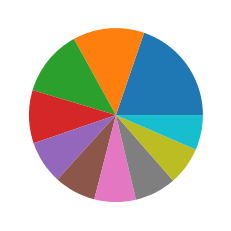

In [ ]:
plt.pie(dataframe_.sort_values('apartment', ascending = False).iloc[:10][['apartment']])